In [2]:
import saflow
import mne
from saflow.utils import array_topoplot, create_pval_mask, get_SAflow_bids
from saflow import RESULTS_PATH, FREQS_NAMES, BIDS_PATH, IMG_DIR
from mlneurotools.stats import compute_pval
from str2bool import str2bool
import argparse
import mne
import itertools
import pickle
import numpy as np
import os.path as op
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import make_axes_locatable
from tqdm.autonotebook import tqdm
from saflow import (
    BIDS_PATH,
    SUBJ_LIST,
    BLOCS_LIST,
    FREQS_NAMES,
    ZONE_CONDS,
    RESULTS_PATH,
    IMG_DIR,
)
import pickle
from saflow.utils import array_topoplot, create_pval_mask, get_SAflow_bids
import numpy as np
from sklearn.model_selection import (
    StratifiedShuffleSplit,
    GroupShuffleSplit,
    ShuffleSplit,
    LeaveOneGroupOut,
    KFold,
)
from mlneurotools.ml import classification, StratifiedShuffleGroupSplit
from mlneurotools.stats import ttest_perm
import argparse
import os
import mne
import random
from tqdm import tqdm
import os.path as op
from scipy import stats
from statsmodels.stats.multitest import fdrcorrection
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import make_axes_locatable
from tqdm.autonotebook import tqdm


# Single feature group-level

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

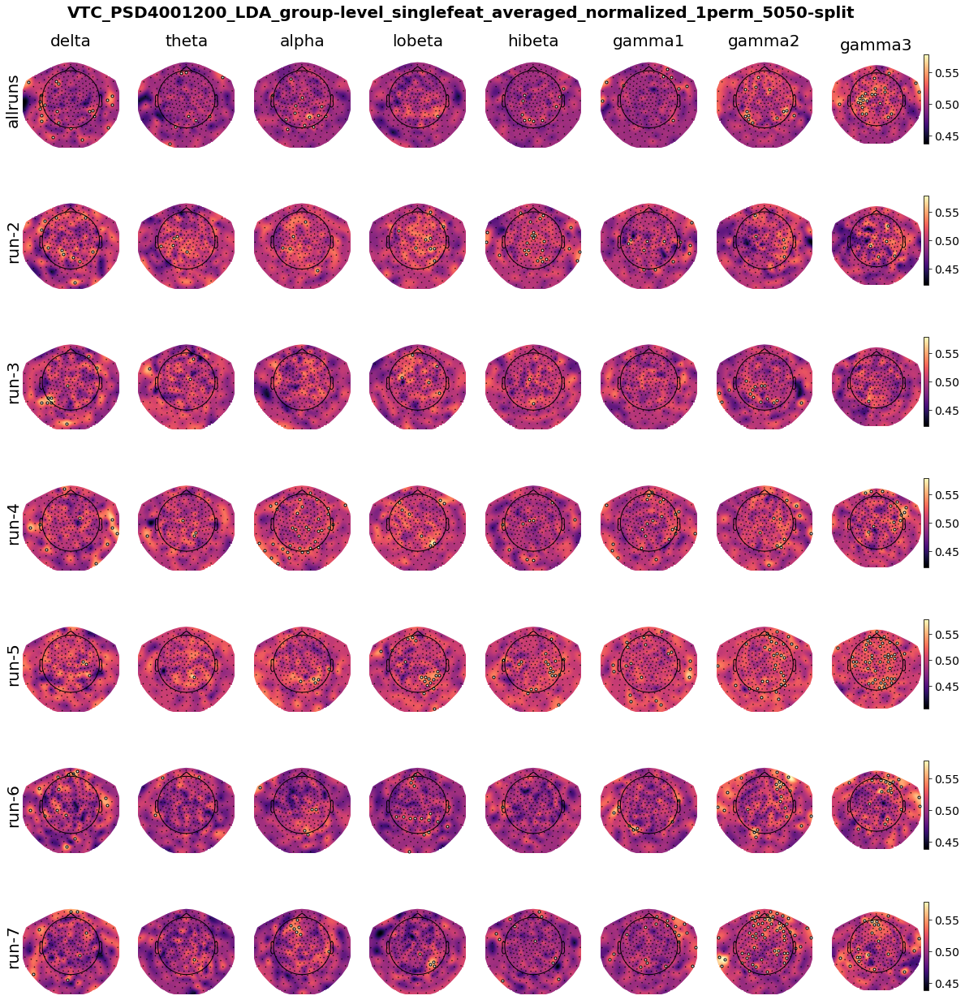

In [77]:


classif_template = "VTC_PSD4001200_LDA_group-level_singlefeat_averaged_normalized_1perm_5050-split_run-{}"
alpha = 0.05
RESULTS_PATH = "/home/hyruuk/GitHub/cc_saflow/results"

epochs = mne.io.read_raw_ctf("/home/hyruuk/pCloudDrive/science/saflow/sub-04_ses-recording_task-gradCPT_run-02_meg.ds", verbose=False)
ch_xy = epochs.pick_types(
    meg=True, ref_meg=False
).info  # Find the channel's position

# Load the data


fig = plt.figure(figsize=(20,20))
fig.suptitle(classif_template[:-7], size=20, weight='heavy')
gs = fig.add_gridspec(7,8)
for idx_run, run in tqdm(enumerate(['allruns', '2', '3', '4', '5', '6', '7'])):
    classif_name = classif_template.format(run)
    savepath = op.join(RESULTS_PATH, classif_name)
    allfreqs_acc = []
    allfreqs_pval = []
    allmasks = []
    for FREQ in tqdm(FREQS_NAMES):
        allchans_acc = []
        allchans_pval = []
        allchans_accperms = []
        for CHAN in range(270):
            savename = "freq_{}_chan_{}.pkl".format(FREQ, CHAN)
            with open(op.join(savepath, savename), "rb") as f:
                result = pickle.load(f)
            allchans_acc.append(result["acc_score"])
            allchans_pval.append(result["acc_pvalue"])
            allchans_accperms.append(result["acc_pscores"])

        # Correction for multiple comparisons
        freq_perms = list(itertools.chain.from_iterable(allchans_accperms))
        corrected_pval = []
        for acc in allchans_acc:
            corrected_pval.append(compute_pval(acc, freq_perms))
        pval_mask = create_pval_mask(np.array(corrected_pval), alpha=alpha)

        allfreqs_acc.append(np.array(allchans_acc).squeeze())
        allfreqs_pval.append(np.array(allchans_pval).squeeze())
        allmasks.append(pval_mask)

    toplot_pval = allfreqs_pval
    figpath_pval = IMG_DIR + classif_name + "_pval" + str(alpha)[2:] + ".png"

    toplot_acc = allfreqs_acc
    figpath_acc = IMG_DIR + classif_name + "_acc" + str(alpha)[2:] + ".png"

    titles = FREQS_NAMES


    # Setup the min and max value of the color scale
    vmax_pval = np.max(np.max(np.asarray(toplot_pval)))
    vmin_pval = np.min(np.min(np.asarray(toplot_pval)))
    
    vmax = np.max(np.max(np.asarray(toplot_acc)))
    vmin = np.min(np.min(np.asarray(toplot_acc)))
    toplot = toplot_acc
    masks = allmasks

    
    # create fig
    mask_params = dict(
        marker="o", markerfacecolor="w", markeredgecolor="k", linewidth=0, markersize=3
    )

    run_names = ['allruns', 'run-2', 'run-3', 'run-4', 'run-5', 'run-6', 'run-7']
    for idx_freq, data in enumerate(toplot):
        ax = fig.add_subplot(gs[idx_run, idx_freq])
        
        image, _ = mne.viz.plot_topomap(
            data=data,
            pos=ch_xy,
            cmap='magma',
            vmin=vmin,
            vmax=vmax,
            axes=ax,
            show=False,
            contours=None,
            mask_params=mask_params,
            mask=masks[idx_freq],
            extrapolate="local",
            outlines="skirt",
            sphere=0.11,
        )
        if idx_run==0:
            # option for title
            ax.set_title(
                titles[idx_freq], fontdict={"fontsize": 20, "fontweight": "medium"}
            )
        if idx_freq==7:
            # add a colorbar at the end of the line (weird trick from https://www.martinos.org/mne/stable/auto_tutorials/stats-sensor-space/plot_stats_spatio_temporal_cluster_sensors.html#sphx-glr-auto-tutorials-stats-sensor-space-plot-stats-spatio-temporal-cluster-sensors-py)
            divider = make_axes_locatable(ax)
            ax_colorbar = divider.append_axes("right", size="5%", pad=0.05)
            plt.colorbar(image, cax=ax_colorbar)
            ax_colorbar.tick_params(labelsize=14)
        if idx_freq==0:
            text = ax.text(-0.25,0, run_names[idx_run] , fontdict={"fontsize": 20, "fontweight": "medium"}, verticalalignment='center', rotation=90)


# Single feature subject-level

In [ ]:


classif_template = "VTC_PSD_LR_subject-level_singlefeat_averaged_normalized_1000perm_5050-split_subj-{}_run-{}"
alpha = 0.05
RESULTS_PATH = "/home/hyruuk/GitHub/cc_saflow/results"

epochs = mne.io.read_raw_ctf("/home/hyruuk/pCloudDrive/science/saflow/sub-04_ses-recording_task-gradCPT_run-02_meg.ds", verbose=False)
ch_xy = epochs.pick_types(
    meg=True, ref_meg=False
).info  # Find the channel's position

# Load the data

for idx_subj, subj in enumerate(SUBJ_LIST):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle(classif_template[:-5], size=20, weight='heavy')
    gs = fig.add_gridspec(7,8)
    for idx_run, run in tqdm(enumerate(['allruns'])):#, '2', '3', '4', '5', '6', '7'])):
        classif_name = classif_template.format(subj, run)
        savepath = op.join(RESULTS_PATH, classif_name)
        allfreqs_acc = []
        allfreqs_pval = []
        allmasks = []
        for FREQ in tqdm(FREQS_NAMES):
            allchans_acc = []
            allchans_pval = []
            allchans_accperms = []
            for CHAN in range(270):
                savename = "freq_{}_chan_{}.pkl".format(FREQ, CHAN)
                with open(op.join(savepath, savename), "rb") as f:
                    result = pickle.load(f)
                allchans_acc.append(result["acc_score"])
                allchans_pval.append(result["acc_pvalue"])
                allchans_accperms.append(result["acc_pscores"])

            # Correction for multiple comparisons
            freq_perms = list(itertools.chain.from_iterable(allchans_accperms))
            corrected_pval = []
            for acc in allchans_acc:
                corrected_pval.append(compute_pval(acc, freq_perms))
            pval_mask = create_pval_mask(np.array(corrected_pval), alpha=alpha)

            allfreqs_acc.append(np.array(allchans_acc).squeeze())
            allfreqs_pval.append(np.array(allchans_pval).squeeze())
            allmasks.append(pval_mask)

        toplot_pval = allfreqs_pval
        figpath_pval = IMG_DIR + classif_name + "_pval" + str(alpha)[2:] + ".png"

        toplot_acc = allfreqs_acc
        figpath_acc = IMG_DIR + classif_name + "_acc" + str(alpha)[2:] + ".png"

        titles = FREQS_NAMES


        # Setup the min and max value of the color scale
        vmax_pval = np.max(np.max(np.asarray(toplot_pval)))
        vmin_pval = np.min(np.min(np.asarray(toplot_pval)))

        vmax = np.max(np.max(np.asarray(toplot_acc)))
        vmin = np.min(np.min(np.asarray(toplot_acc)))
        toplot = toplot_acc
        masks = allmasks


        # create fig
        mask_params = dict(
            marker="o", markerfacecolor="w", markeredgecolor="k", linewidth=0, markersize=3
        )

        run_names = ['allruns', 'run-2', 'run-3', 'run-4', 'run-5', 'run-6', 'run-7']
        for idx_freq, data in enumerate(toplot):
            ax = fig.add_subplot(gs[idx_run, idx_freq])

            image, _ = mne.viz.plot_topomap(
                data=data,
                pos=ch_xy,
                cmap='magma',
                vmin=vmin,
                vmax=vmax,
                axes=ax,
                show=False,
                contours=None,
                mask_params=mask_params,
                mask=masks[idx_freq],
                extrapolate="local",
                outlines="skirt",
                sphere=0.11,
            )
            if idx_run==0:
                # option for title
                ax.set_title(
                    titles[idx_freq], fontdict={"fontsize": 20, "fontweight": "medium"}
                )
            if idx_freq==7:
                # add a colorbar at the end of the line (weird trick from https://www.martinos.org/mne/stable/auto_tutorials/stats-sensor-space/plot_stats_spatio_temporal_cluster_sensors.html#sphx-glr-auto-tutorials-stats-sensor-space-plot-stats-spatio-temporal-cluster-sensors-py)
                divider = make_axes_locatable(ax)
                ax_colorbar = divider.append_axes("right", size="5%", pad=0.05)
                plt.colorbar(image, cax=ax_colorbar)
                ax_colorbar.tick_params(labelsize=14)
            if idx_freq==0:
                text = ax.text(-0.25,0, run_names[idx_run] , fontdict={"fontsize": 20, "fontweight": "medium"}, verticalalignment='center', rotation=90)


# Ttest group-level

0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.
Removing 5 compensators from info because not all compensation channels were picked.
Removing 5 compensators from info because not all compensation channels were picked.
Removing 5 compensators from info because not all compensation channels were picked.
Removing 5 compensators from info because not all compensation channels were picked.
Removing 5 compensators from info because not all compensation channels were picked.
Removing 5 compensators from info because not all compensation channels were picked.


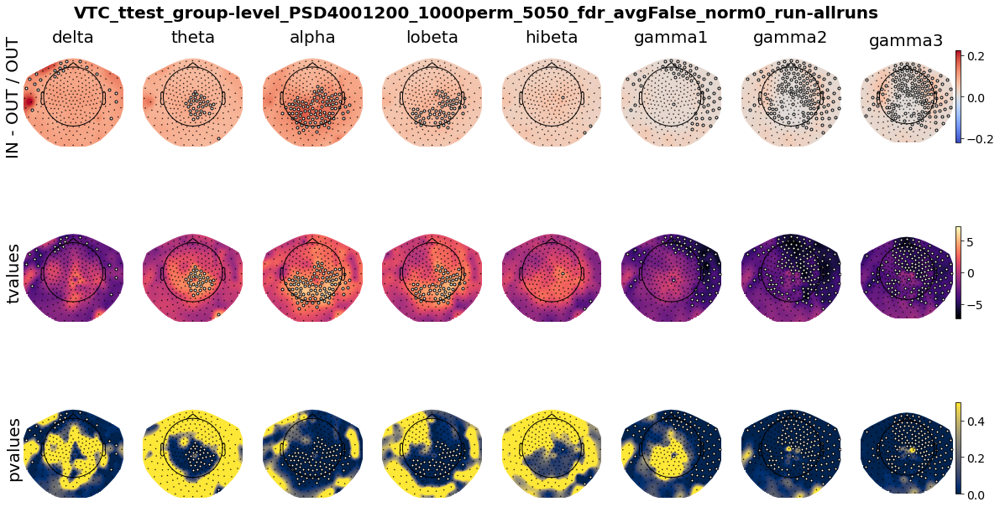

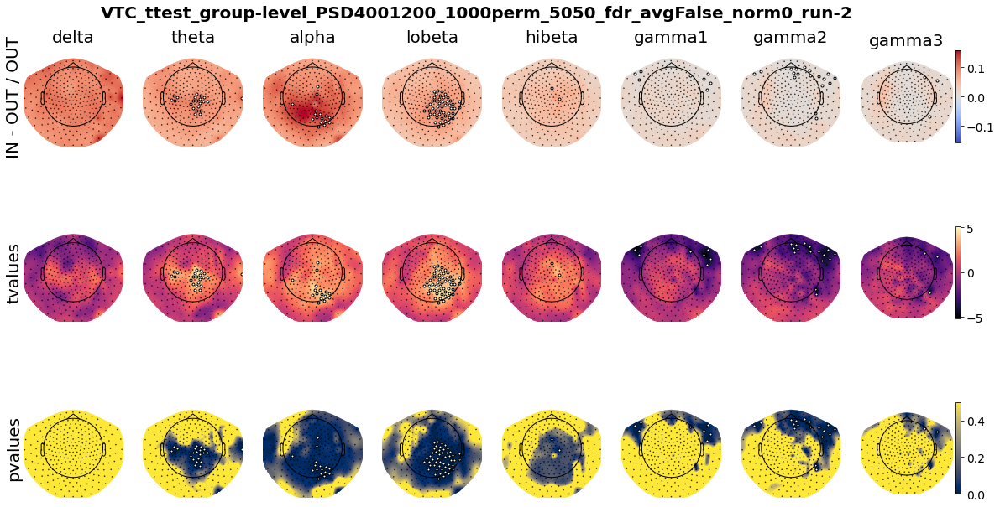

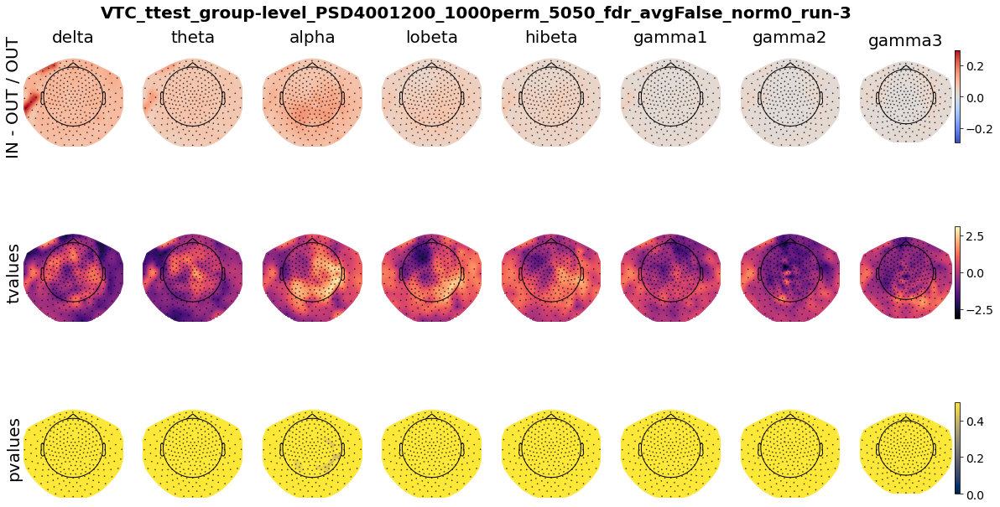

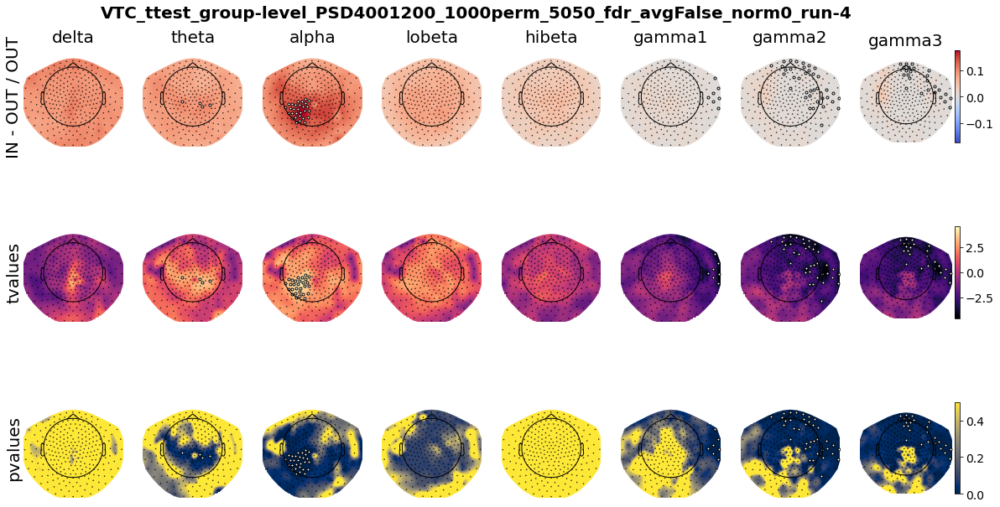

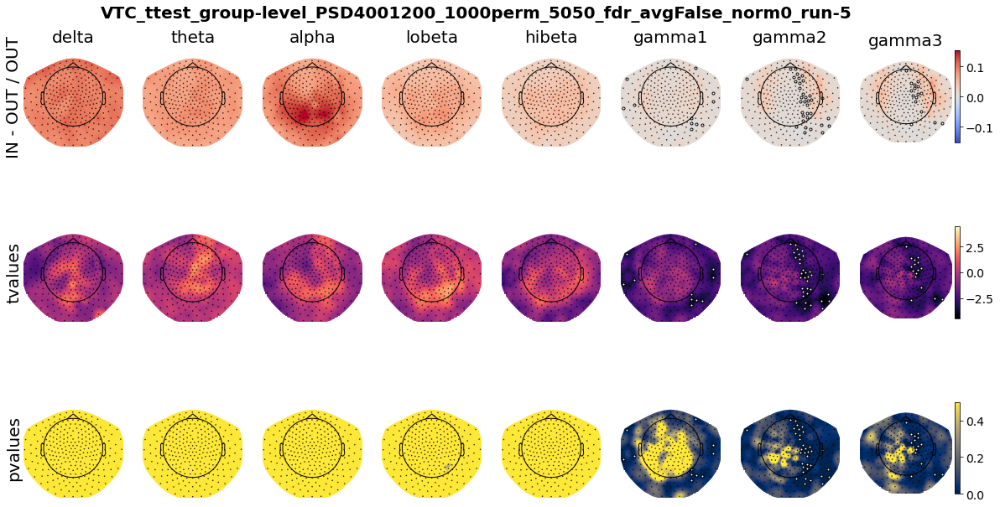

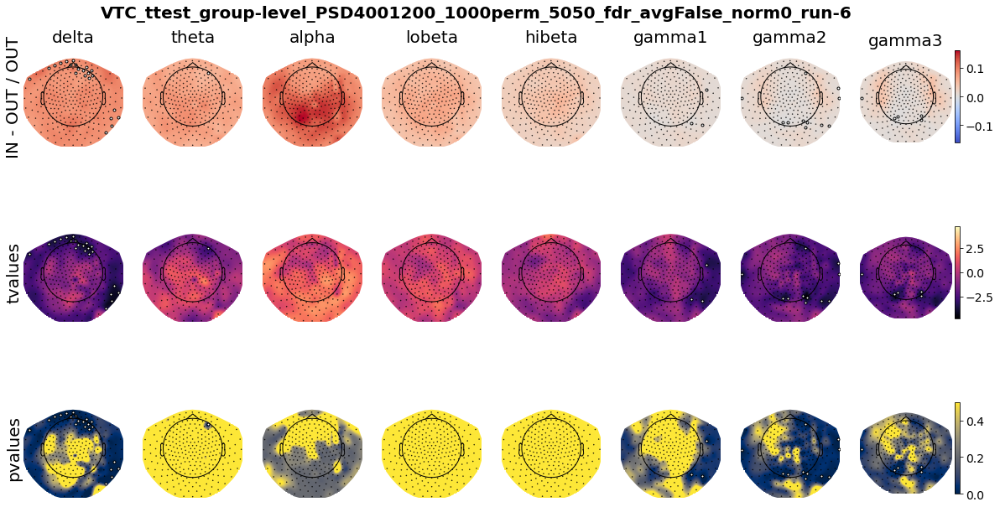

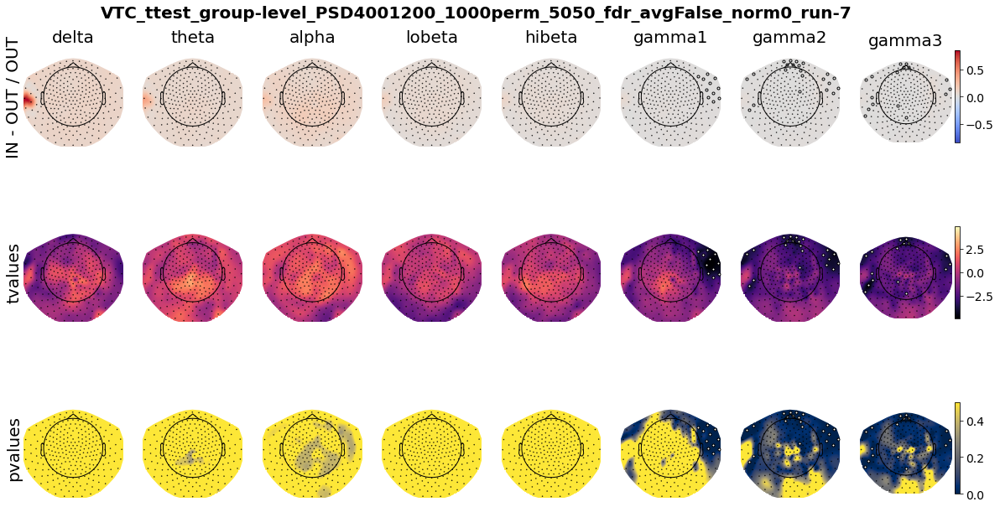

In [78]:
# TODO : (au besoin)
#- ajuster colorbar pour gammas
#- désactiver masks pour contrasts


for idx_run, run in tqdm(enumerate(['allruns', '2', '3', '4', '5', '6', '7'])):
    ttests_name = 'VTC_ttest_group-level_PSD4001200_1000perm_5050_fdr_avgFalse_norm0_run-' + run

    if 'VTC' in ttests_name:
        conds_list = ['IN', 'OUT']
    elif 'odd' in ttests_name:
        conds_list = ["Freq", "Rare"]

    fig = plt.figure(figsize=(20, 10))
    fig.suptitle(ttests_name, size=20, weight='heavy')
    gs = fig.add_gridspec(3, 8)
    alpha = 0.001
    titles = FREQS_NAMES

    alltvals = []
    allcontrasts = []
    masks = []
    allpvals = []
    RESULTS_PATH = "/home/hyruuk/GitHub/cc_saflow/results"
    savepath = op.join(RESULTS_PATH, ttests_name)
    for FREQ in range(len(FREQS_NAMES)):
        savename = "PSD_ttest_{}.pkl".format(FREQS_NAMES[FREQ])
        with open(op.join(savepath, savename), "rb") as f:
            datafile = pickle.load(f)

            allcontrasts.append(datafile['contrast'])
            alltvals.append(datafile['tvals'])
            allpvals.append(datafile['pvals'])
        masks.append(create_pval_mask(datafile["pvals"], alpha=alpha))

    # Plots
    # obtain chan locations
    epochs = mne.io.read_raw_ctf("/home/hyruuk/pCloudDrive/science/saflow/sub-04_ses-recording_task-gradCPT_run-02_meg.ds", verbose=False)
    ch_xy = epochs.pick_types(
        meg=True, ref_meg=False
    ).info  # Find the channel positions

    toplots = [allcontrasts, alltvals, allpvals]

    # create fig
    mask_params = dict(
        marker="o", markerfacecolor="w", markeredgecolor="k", linewidth=0, markersize=3
    )
    cmaps = ["coolwarm", "magma", "cividis"]
    vmaxs = [
        np.max(np.max(abs(np.asarray(allcontrasts)))),
        np.max(np.max(abs(np.asarray(alltvals)))),
        0.5,
    ]
    vmins = [-vmaxs[0], -vmaxs[1], 0]
    metric_names = [
        f"{conds_list[0]} - {conds_list[1]} / {conds_list[1]}",
        "tvalues",
        "pvalues",
    ]
    for idx_metric, toplot in enumerate(toplots):
        for idx_freq, data in enumerate(toplot):
            ax = fig.add_subplot(gs[idx_metric, idx_freq])
            vmax = vmaxs[idx_metric]
            vmin = vmins[idx_metric]
            image, _ = mne.viz.plot_topomap(
                data=data,
                pos=ch_xy,
                cmap=cmaps[idx_metric],
                vmin=vmins[idx_metric],
                vmax=vmaxs[idx_metric],
                axes=ax,
                show=False,
                contours=None,
                mask_params=mask_params,
                mask=masks[idx_freq],
                extrapolate="local",
                outlines="head",
                sphere=0.11,
            )
            if idx_metric == 0:
                # option for title
                ax.set_title(
                    titles[idx_freq], fontdict={"fontsize": 20, "fontweight": "medium"}
                )
            if idx_freq == 7:
                # add a colorbar at the end of the line (weird trick from https://www.martinos.org/mne/stable/auto_tutorials/stats-sensor-space/plot_stats_spatio_temporal_cluster_sensors.html#sphx-glr-auto-tutorials-stats-sensor-space-plot-stats-spatio-temporal-cluster-sensors-py)
                divider = make_axes_locatable(ax)
                ax_colorbar = divider.append_axes("right", size="5%", pad=0.05)
                plt.colorbar(image, cax=ax_colorbar)
                ax_colorbar.tick_params(labelsize=14)
            if idx_freq == 0:
                text = ax.text(
                    -0.25,
                    0,
                    metric_names[idx_metric],
                    fontdict={"fontsize": 20, "fontweight": "medium"},
                    verticalalignment="center",
                    rotation=90,
                )


# Ttest subject-level

0it [00:00, ?it/s]

0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


/tmp/ipykernel_97982/752765136.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(20, 10))


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


0it [00:00, ?it/s]

Removing 5 compensators from info because not all compensation channels were picked.


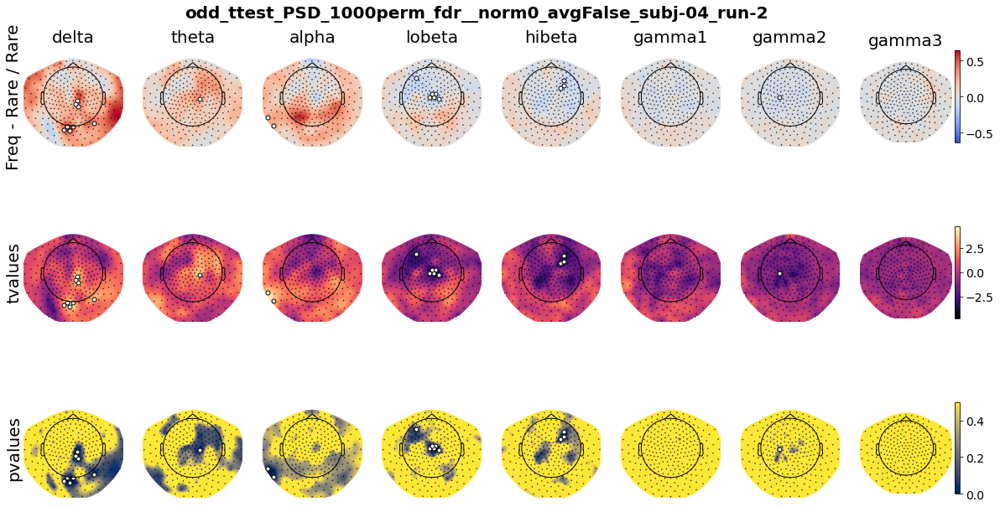

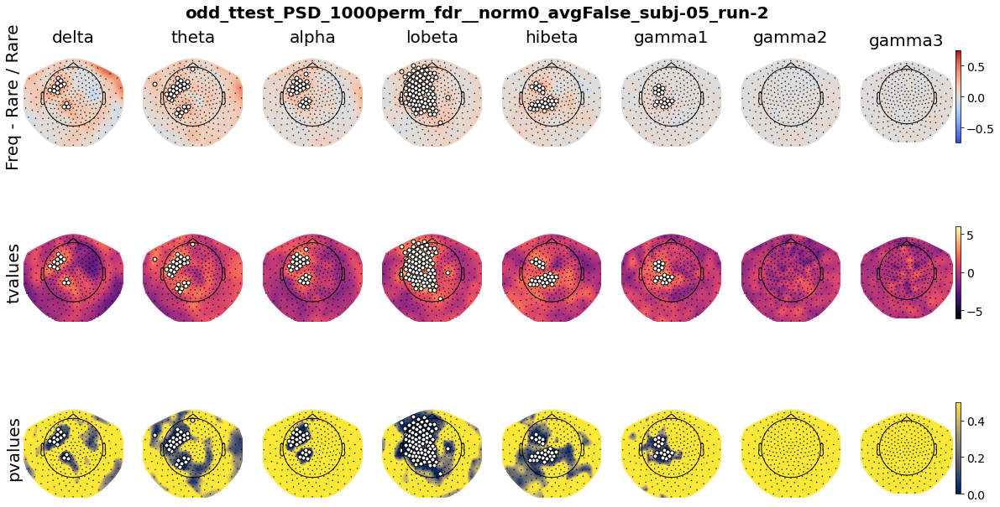

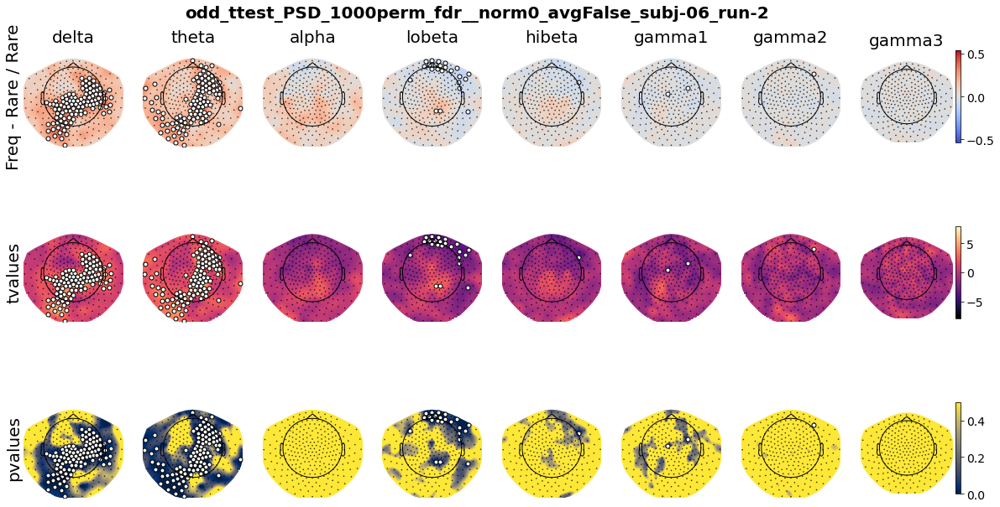

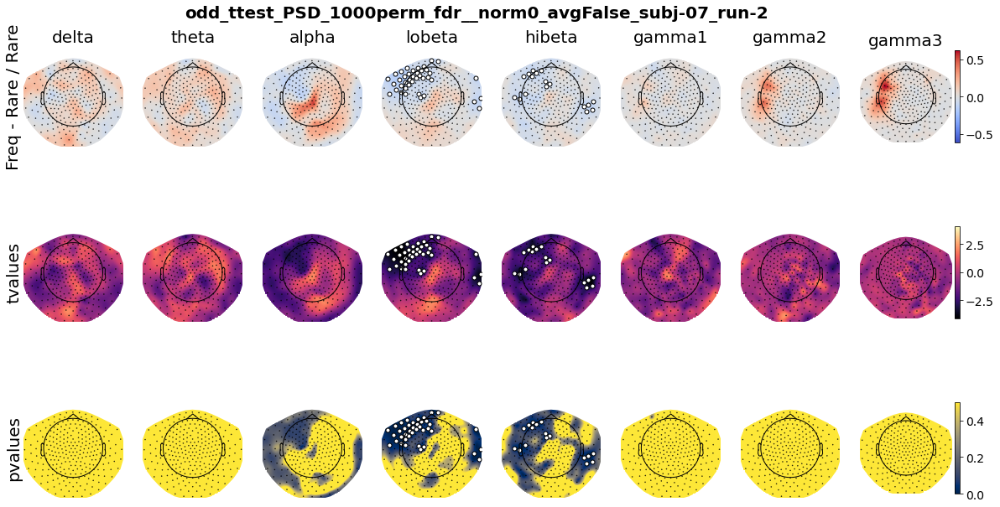

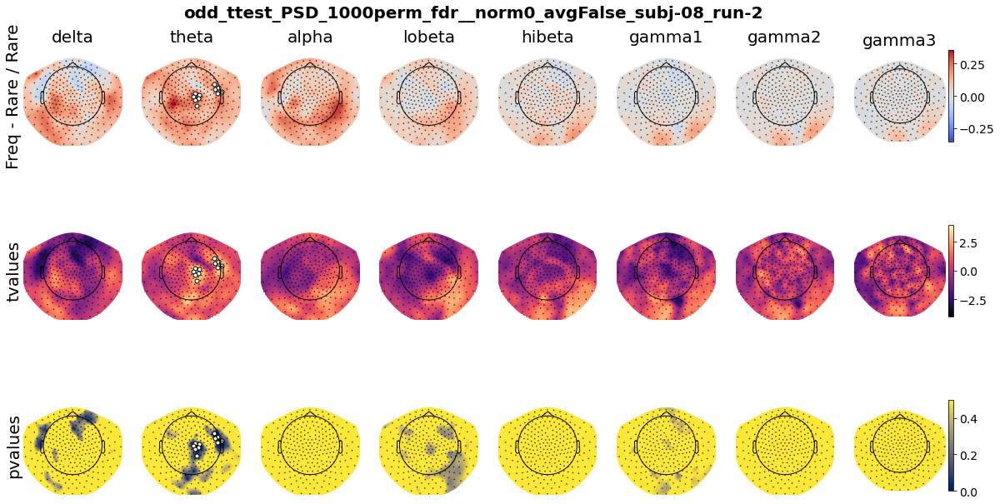

...

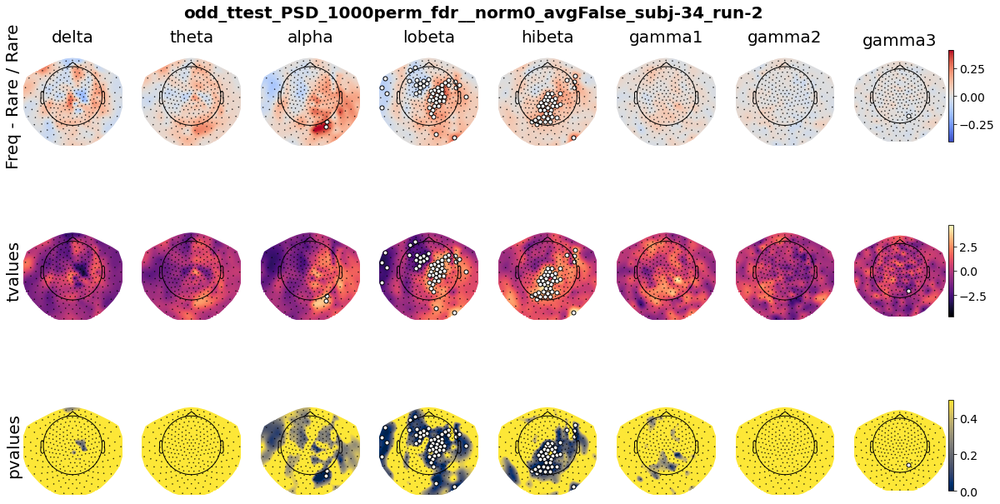

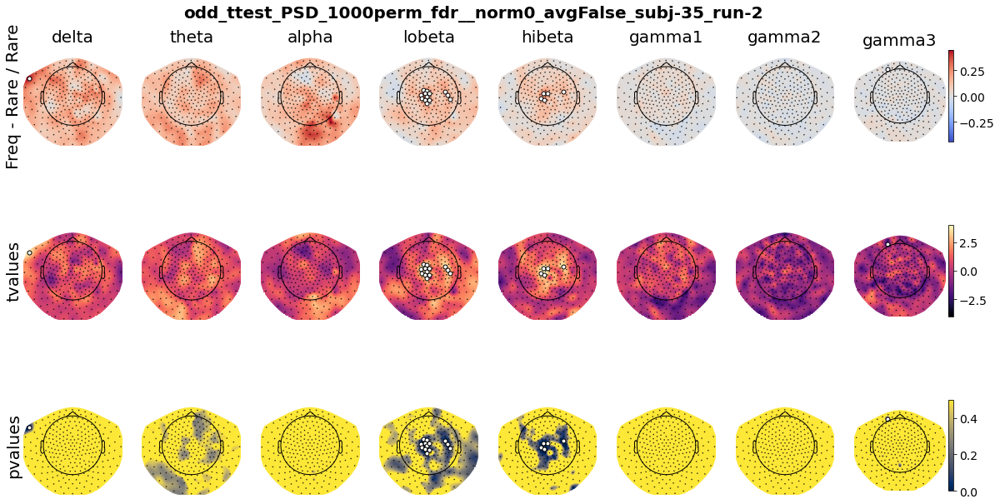

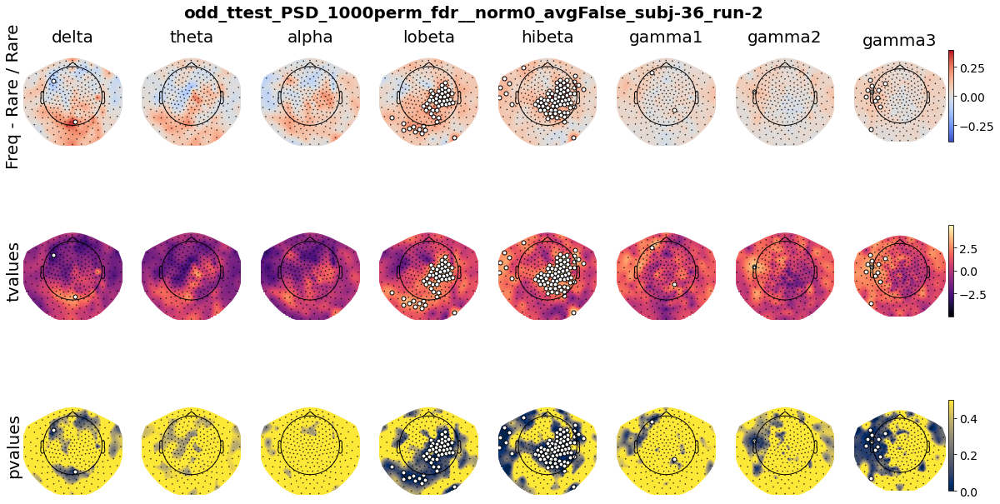

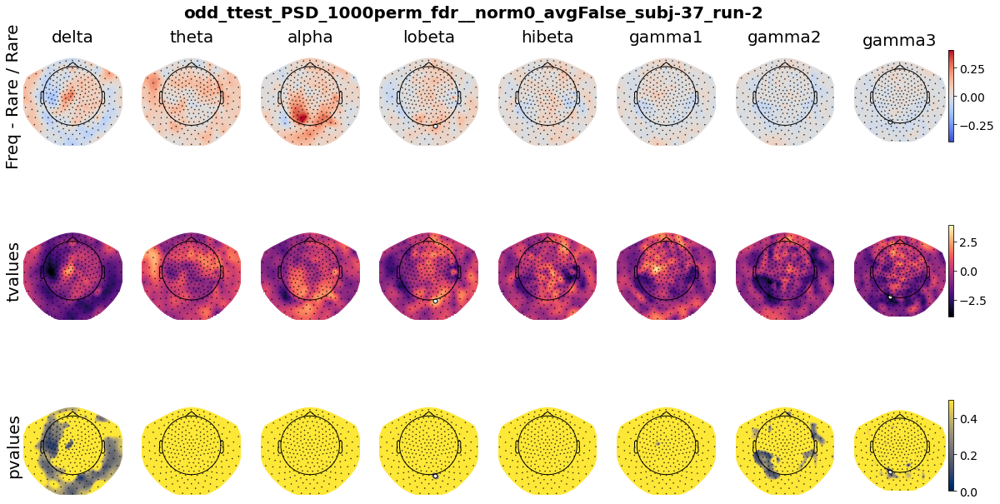

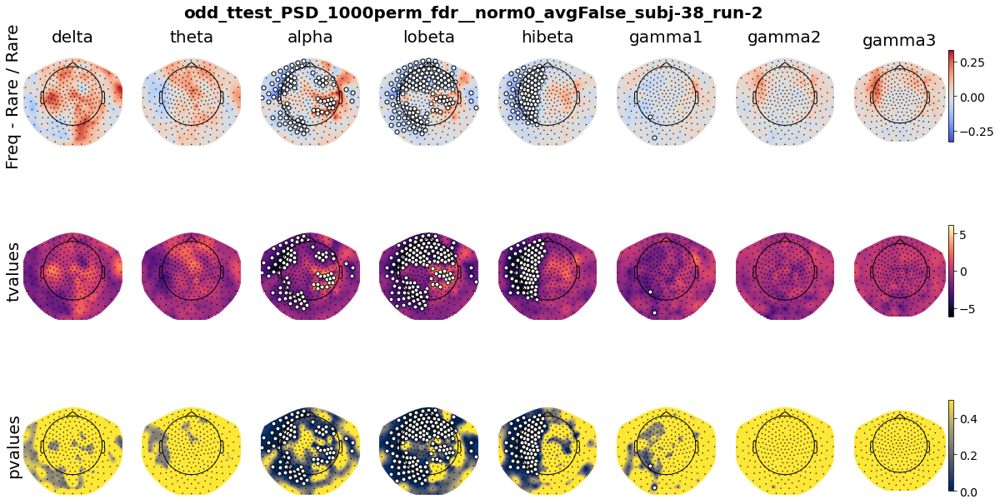

In [65]:

ttests_template = 'odd_ttest_PSD_1000perm_fdr__norm0_avgFalse_subj-{}_run-{}'

for idx_subj, subj in tqdm(enumerate(SUBJ_LIST)):
    for idx_run, run in tqdm(enumerate(['2'])):#, '2', '3', '4', '5', '6', '7'])):
        ttests_name = ttests_template.format(subj, run)

        if 'VTC' in ttests_name:
            conds_list = ['IN', 'OUT']
        elif 'odd' in ttests_name:
            conds_list = ["Freq", "Rare"]

        fig = plt.figure(figsize=(20, 10))
        fig.suptitle(ttests_name, size=20, weight='heavy')
        gs = fig.add_gridspec(3, 8)
        alpha = 0.05
        titles = FREQS_NAMES

        alltvals = []
        allcontrasts = []
        masks = []
        allpvals = []
        RESULTS_PATH = "/home/hyruuk/GitHub/cc_saflow/results"
        savepath = op.join(RESULTS_PATH, ttests_name)
        for FREQ in range(len(FREQS_NAMES)):
            savename = "PSD_ttest_{}.pkl".format(FREQS_NAMES[FREQ])
            with open(op.join(savepath, savename), "rb") as f:
                datafile = pickle.load(f)

                allcontrasts.append(datafile['contrast'])
                alltvals.append(datafile['tvals'])
                allpvals.append(datafile['pvals'])
            masks.append(create_pval_mask(datafile["pvals"], alpha=alpha))

        # Plots
        # obtain chan locations
        epochs = mne.io.read_raw_ctf("/home/hyruuk/pCloudDrive/science/saflow/sub-04_ses-recording_task-gradCPT_run-02_meg.ds", verbose=False)
        ch_xy = epochs.pick_types(
            meg=True, ref_meg=False
        ).info  # Find the channel positions

        toplots = [allcontrasts, alltvals, allpvals]

        # create fig
        mask_params = dict(
            marker="o", markerfacecolor="w", markeredgecolor="k", linewidth=0, markersize=3
        )
        cmaps = ["coolwarm", "magma", "cividis"]
        vmaxs = [
            np.max(np.max(abs(np.asarray(allcontrasts)))),
            np.max(np.max(abs(np.asarray(alltvals)))),
            0.5,
        ]
        vmins = [-vmaxs[0], -vmaxs[1], 0]
        metric_names = [
            f"{conds_list[0]} - {conds_list[1]} / {conds_list[1]}",
            "tvalues",
            "pvalues",
        ]
        for idx_metric, toplot in enumerate(toplots):
            for idx_freq, data in enumerate(toplot):
                ax = fig.add_subplot(gs[idx_metric, idx_freq])
                vmax = vmaxs[idx_metric]
                vmin = vmins[idx_metric]
                image, _ = mne.viz.plot_topomap(
                    data=data,
                    pos=ch_xy,
                    cmap=cmaps[idx_metric],
                    vmin=vmins[idx_metric],
                    vmax=vmaxs[idx_metric],
                    axes=ax,
                    show=False,
                    contours=None,
                    mask_params=mask_params,
                    mask=masks[idx_freq],
                    extrapolate="local",
                    outlines="head",
                    sphere=0.11,
                )
                if idx_metric == 0:
                    # option for title
                    ax.set_title(
                        titles[idx_freq], fontdict={"fontsize": 20, "fontweight": "medium"}
                    )
                if idx_freq == 7:
                    # add a colorbar at the end of the line (weird trick from https://www.martinos.org/mne/stable/auto_tutorials/stats-sensor-space/plot_stats_spatio_temporal_cluster_sensors.html#sphx-glr-auto-tutorials-stats-sensor-space-plot-stats-spatio-temporal-cluster-sensors-py)
                    divider = make_axes_locatable(ax)
                    ax_colorbar = divider.append_axes("right", size="5%", pad=0.05)
                    plt.colorbar(image, cax=ax_colorbar)
                    ax_colorbar.tick_params(labelsize=14)
                if idx_freq == 0:
                    text = ax.text(
                        -0.25,
                        0,
                        metric_names[idx_metric],
                        fontdict={"fontsize": 20, "fontweight": "medium"},
                        verticalalignment="center",
                        rotation=90,
                    )


In [ ]:
ax = fig.add_subplot(gs[idx_run, idx_freq])

In [ ]:
!pip install statsmodels